In [1]:
from dataset.protocol import Protocol
from dataset.data_loaders import Patch_Classifier_Dataset

mk = Protocol("C:/Users/b_charmettant/data/immuno/", 'MK1454')

train_dataset = Patch_Classifier_Dataset([mk], 0.4,
                                         resize=224,
                                         transform=None,
                                         subset='train',
                                         experiment="exp_3")


In [2]:
print(len(train_dataset.patches))
print(sum(train_dataset.labels[:,0]))

189
127


In [3]:
from torchvision.transforms import Compose, RandomHorizontalFlip, RandomVerticalFlip, ColorJitter
from utils.augmentation import Rotate_90
from torch.utils.data import DataLoader

transformations = Compose([
                           ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0),
                        ])


train_dataset = Patch_Classifier_Dataset([mk], 0.4,
                                         resize=224,
                                         transform=transformations,
                                         subset='train',
                                         experiment="exp_3")


train_loader = DataLoader(train_dataset, batch_size=1, shuffle=False)

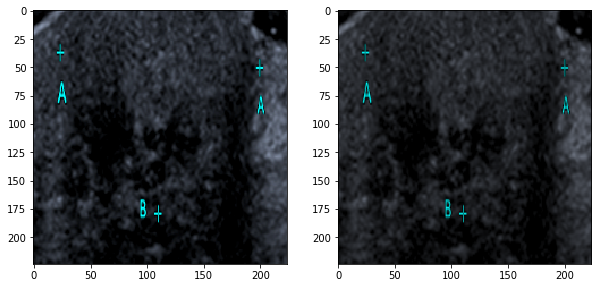

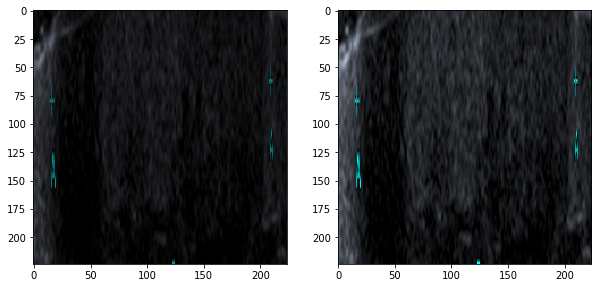

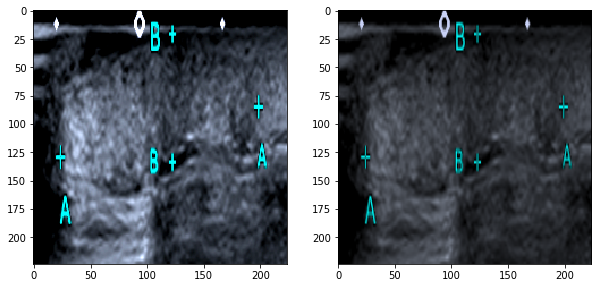

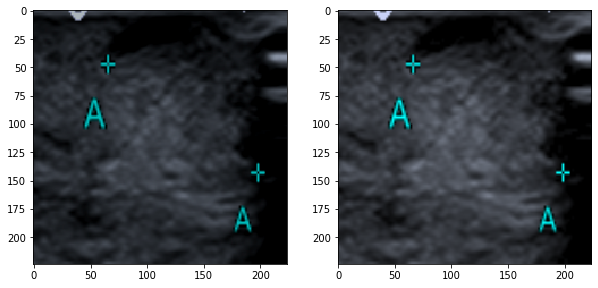

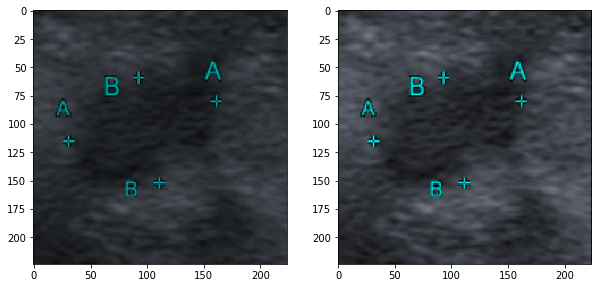

...

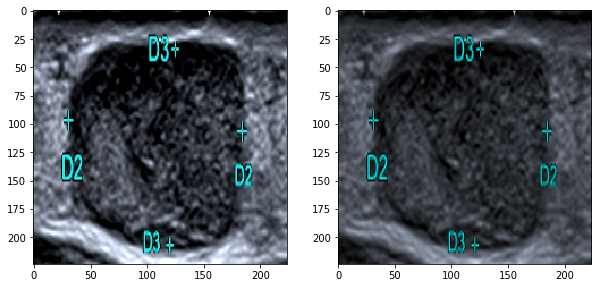

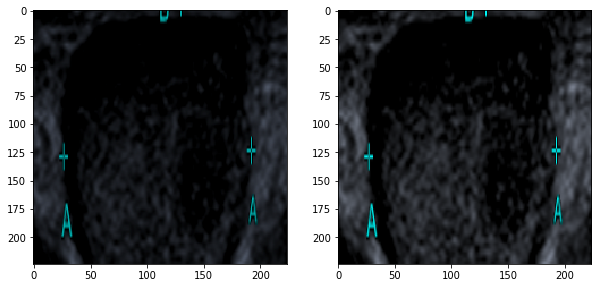

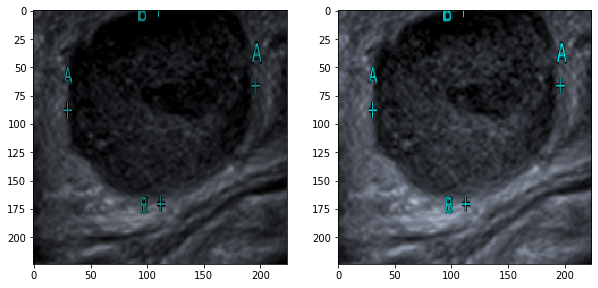

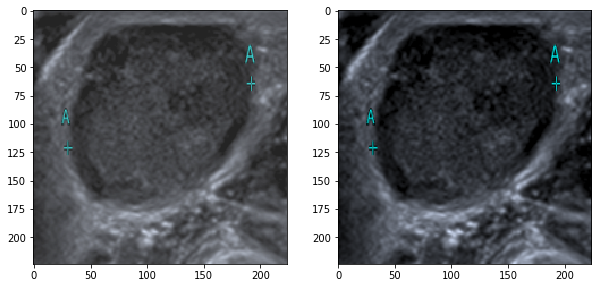

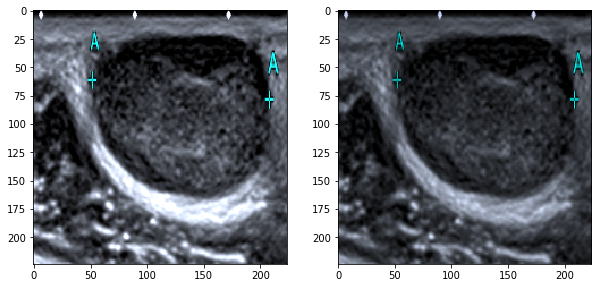

In [ ]:
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = [10, 5]

i = 0
for patch, label in train_loader:
    patch = patch.cpu().numpy().reshape(224, 224, 3)
    
    original = train_dataset.patches[i].reshape(224,224,3)
    
    fig, axis = plt.subplots(1, 2)
    
    axis[0].imshow(patch)
    axis[1].imshow(original)
    plt.show()
    
    i=i+1
    
    